In [3]:
import pandas as pd
import os
import numpy as np
import math

os.environ["KERAS_BACKEND"] = "tensorflow"

import random
import numpy as np
from glob import glob
from PIL import Image, ImageOps
import matplotlib.pyplot as plt

import keras
from keras import layers

import tensorflow as tf
import zipfile
import os

In [4]:
zipp = "E:/Train/Train.zip"
extractt = "E:/Train/Extracted"
print("zip file taken from",extractt)

os.makedirs(extractt, exist_ok=True)

with zipfile.ZipFile(zipp, 'r') as zip_ref:
    zip_ref.extractall(extractt)

print("Extraction completed")


zip file taken from E:/Train/Extracted
Extraction completed


In [5]:
import tensorflow as tf
import glob

IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_TRAIN_IMAGES = 400

def load_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(image, [IMAGE_SIZE, IMAGE_SIZE])
    image = tf.cast(image, tf.float32) / 255.0
    return image

def data_generator(image_paths):
    dataset = tf.data.Dataset.from_tensor_slices(image_paths)
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


train_low_light_images = sorted(glob.glob("./Train/low/*"))[:MAX_TRAIN_IMAGES]
val_low_light_images = sorted(glob.glob("./Train/low/*"))[MAX_TRAIN_IMAGES:]
test_low_light_images = sorted(glob.glob("./Train/test/low/*"))

# 
train_dataset = data_generator(train_low_light_images)
val_dataset = data_generator(val_low_light_images)


print("Train Dataset:", train_dataset)
print("Validation Dataset:", val_dataset)


for batch in train_dataset.take(1):
    print("Train Batch Shape:", batch.shape)
    


Train Dataset: <_BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>
Validation Dataset: <_BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>
Train Batch Shape: (16, 256, 256, 3)


In [6]:
import tensorflow.keras as keras
from tensorflow.keras import layers

def build_dce_net():
    input_img = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(input_img)
    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)
    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)
    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(
        int_con3
    )
    model = keras.Model(inputs=input_img, outputs=x_r)
    return model

def build_other_net():
    input_img = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(input_img)
    conv2 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv1)
    conv3 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv2)
    conv4 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu", padding="same")(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(12, (3, 3), strides=(1, 1), activation="tanh", padding="same")(int_con3)
    model = keras.Model(inputs=input_img, outputs=x_r)
    return model


In [7]:
def lossconsist(x):
    meanrgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mr, mg, mb = (meanrgb[:, :, :, 0],meanrgb[:, :, :, 1], meanrgb[:, :, :, 2],)
    meancrg = tf.square(mr - mg)
    meancgb = tf.square(mb - mg)
    meancrb = tf.square(mr - mb)
    return tf.sqrt(tf.square(meancrg) + tf.square(meancrb) + tf.square(meancgb))
def constant(x):
     meanrg = tf.reduce_mean(y, axis=(3, 4), keepdims=False)
    #okr, okg, okb = (meanrgb[:, :, :, 2],meanrgb[:, :, :, 3], meanrgb[:, :, :, 4],)
   # meancrg = tf.square(x)
    #meancgb = tf.square(x)
    #meancrb = tf.square(x)
   
#return tf.(tf.square(meanscrg) + tf.square(meancrb) + tf.square(meancgb))
    

In [8]:
def lostexpo2(x, mean_val=0.8):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))
def lostexpo(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))
def lostexpo3(x, mean_val=0.4):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))
print("lostexpo to be used with 0.6 value")


lostexpo to be used with 0.6 value


In [9]:
def lostsm(x):
    batchsize = tf.shape(x)[0]
    first = tf.shape(x)[1]
    second = tf.shape(x)[2]
    count_first = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_second = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    firsts = tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:,:first - 1, :, :])))
    seconds = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : second - 1, :])))
    
    count_h = tf.cast(count_first, dtype=tf.float32)
    batchsize = tf.cast(batchsize, dtype=tf.float32)
    count_w = tf.cast(count_second, dtype=tf.float32)
    return 2*(firsts / count_h + seconds / count_w)/batchsize
def lostm1(x):
    batchsize = tf.shape(x)[0]
    first = tf.shape(x)[1]
    second = tf.shape(x)[2]
    count_first = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_second = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    firsts=tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:,:first - 1, :, :])))
    seconds = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : second - 1, :])))
    count_h = tf.cast(count_first, dtype=tf.float32)
    batchsize = tf.cast(batchsize, dtype=tf.float32)
    count_w = tf.cast(count_second, dtype=tf.float32)
    return 2*(firsts / count_h + seconds / count_w)/batchsize
print("tf.shape(x)[1],tf.shape(x)[2]")

tf.shape(x)[1],tf.shape(x)[2]


In [10]:
class consistencycheck(keras.losses.Loss):
    def __init__(self, **kwargs):
        super().__init__(reduction="none")

        self.left_kernel = tf.constant([[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32)
        self.right_kernel = tf.constant([[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32)
        self.up_kernel = tf.constant([[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32)
        self.down_kernel = tf.constant([[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32)

    def call(self, yue, yed):
        initialavg = tf.reduce_mean(yue, 3, keepdims=True)
        finalavg = tf.reduce_mean(yed, 3, keepdims=True)
        initialpool = tf.nn.avg_pool2d(initialavg, ksize=4, strides=4, padding="VALID")
        finalpool = tf.nn.avg_pool2d(finalavg, ksize=4, strides=4, padding="VALID")
        dinitialleft = tf.nn.conv2d(initialpool,self.left_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        dinitialright = tf.nn.conv2d(initialpool,self.right_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        dinitialup = tf.nn.conv2d(initialpool,self.up_kernel, strides=[1, 1, 1, 1], padding="SAME")
        dinitialdown = tf.nn.conv2d(initialpool,self.down_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        dfinalleft = tf.nn.conv2d(finalpool,self.left_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        dfinalright = tf.nn.conv2d(finalpool,self.right_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        dfinalup = tf.nn.conv2d(finalpool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME")
        dfinaldown = tf.nn.conv2d(finalpool,self.down_kernel,strides=[1, 1, 1, 1],padding="SAME",)
        d_left = tf.square(dinitialleft - dfinalleft)
        d_right = tf.square(dinitialright - dfinalright)
        d_up = tf.square(dinitialup - dfinalup)
        d_down = tf.square(dinitialdown - dfinaldown)
        return d_left + d_right + d_up + d_down

In [11]:
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.dce_model = build_dce_net()

    def compile(self, learning_rate, **kwargs):
        super().compile(**kwargs)
        self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = consistencycheck(reduction="none")
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.lostsmtracker = keras.metrics.Mean(name="lostsm")
        self.spatial_constancy_loss_tracker = keras.metrics.Mean(name="spatial_constancy_loss")
        self.lossconsisttracker = keras.metrics.Mean(name="lossconsist")
        self.lostexpotracker = keras.metrics.Mean(name="lostexpo")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.lostsmtracker,
            self.spatial_constancy_loss_tracker,
            self.lossconsisttracker,
            self.lostexpotracker,
        ]

    def finalimagegen(self, data, output):
        r1 = output[:, :, :, :3]
        r2 = output[:, :, :, 3:6]
        r3 = output[:, :, :, 6:9]
        r4 = output[:, :, :, 9:12]
        r5 = output[:, :, :, 12:15]
        r6 = output[:, :, :, 15:18]
        r7 = output[:, :, :, 18:21]
        r8 = output[:, :, :, 21:24]
        x = data + r1 * (tf.square(data) - data)
        x = x + r2 * (tf.square(x) - x)
        x = x + r3 * (tf.square(x) - x)
        finalimage = x + r4 * (tf.square(x) - x)
        x = finalimage + r5 * (tf.square(finalimage) - finalimage)
        x = x + r6 * (tf.square(x) - x)
        x = x + r7 * (tf.square(x) - x)
        finalimage = x + r8 * (tf.square(x) - x)
        return finalimage

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.finalimagegen(data, dce_net_output)

    def compute_losses(self, data, output):
        finalimage = self.finalimagegen(data, output)
        loss_illumination = 200 * lostsm(output)
        loss_spatial_constancy = tf.reduce_mean(
            self.spatial_constancy_loss(finalimage, data)
        )
        loss_color_constancy = 5 * tf.reduce_mean(lossconsist(finalimage))
        loss_exposure = 10 * tf.reduce_mean(lostexpo(finalimage))
        total_loss = (
            loss_illumination
            + loss_spatial_constancy
            + loss_color_constancy
            + loss_exposure
        )

        return {
            "total_loss": total_loss,
            "lostsm": loss_illumination,
            "spatial_constancy_loss": loss_spatial_constancy,
            "lossconsist": loss_color_constancy,
            "lostexpo": loss_exposure,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)

        gradients = tape.gradient(losses["total_loss"], self.dce_model.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
        self.total_loss_tracker.update_state(losses["total_loss"])
        self.lostsmtracker.update_state(losses["lostsm"])
        self.spatial_constancy_loss_tracker.update_state(losses["spatial_constancy_loss"])
        self.lossconsisttracker.update_state(losses["lossconsist"])
        self.lostexpotracker.update_state(losses["lostexpo"])

        return {metric.name: metric.result() for metric in self.metrics}

    def test_step(self, data):
        output = self.dce_model(data)
        losses = self.compute_losses(data, output)

        self.total_loss_tracker.update_state(losses["total_loss"])
        self.lostsmtracker.update_state(
            losses["lostsm"]
        )
        self.spatial_constancy_loss_tracker.update_state(
            losses["spatial_constancy_loss"]
        )
        self.lossconsisttracker.update_state(losses["lossconsist"])
        self.lostexpotracker.update_state(losses["lostexpo"])

        return {metric.name: metric.result() for metric in self.metrics}

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        
        self.dce_model.save_weights(
            filepath,
            overwrite=overwrite,
            save_format=save_format,
            options=options,
        )

    def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
        
        self.dce_model.load_weights(
            filepath=filepath,
            by_name=by_name,
            skip_mismatch=skip_mismatch,
            options=options,
        )

Epoch 1/200
25/25 ━━━━━━━━━━━━━━━━━━━━ 129s 5s/step - lossconsist: 0.0037 - lostexpo: 2.9810 - lostsm: 1.9673 - spatial_constancy_loss: 3.5438e-05 - total_loss: 4.9520 - val_lossconsist: 0.0022 - val_lostexpo: 2.9385 - val_lostsm: 2.4748 - val_spatial_constancy_loss: 3.1362e-05 - val_total_loss: 5.4155
Epoch 2/200
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - lossconsist: 0.0032 - lostexpo: 2.9754 - lostsm: 1.0875 - spatial_constancy_loss: 3.6269e-05 - total_loss: 4.0661 - val_lossconsist: 0.0023 - val_lostexpo: 2.9278 - val_lostsm: 1.5418 - val_spatial_constancy_loss: 4.5649e-05 - val_total_loss: 4.4719
Epoch 3/200
25/25 ━━━━━━━━━━━━━━━━━━━━ 125s 5s/step - lossconsist: 0.0032 - lostexpo: 2.9649 - lostsm: 0.6761 - spatial_constancy_loss: 5.2086e-05 - total_loss: 3.6443 - val_lossconsist: 0.0024 - val_lostexpo: 2.9166 - val_lostsm: 1.0265 - val_spatial_constancy_loss: 6.4356e-05 - val_total_loss: 3.9455
Epoch 4/200
25/25 ━━━━━━━━━━━━━━━━━━━━ 126s 5s/step - lossconsist: 0.0034 - lostexpo: 2.

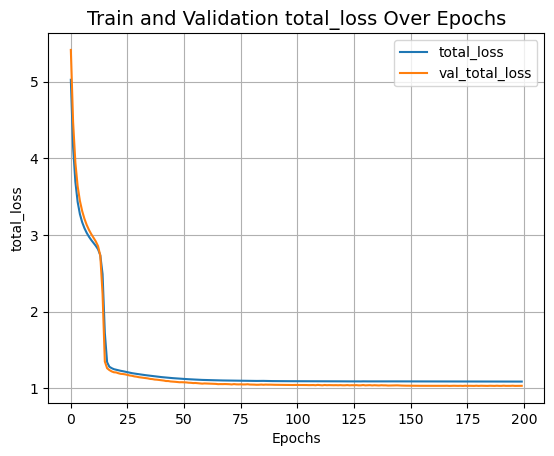

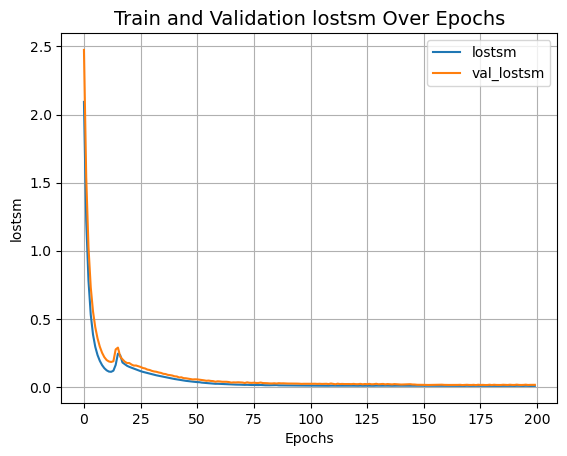

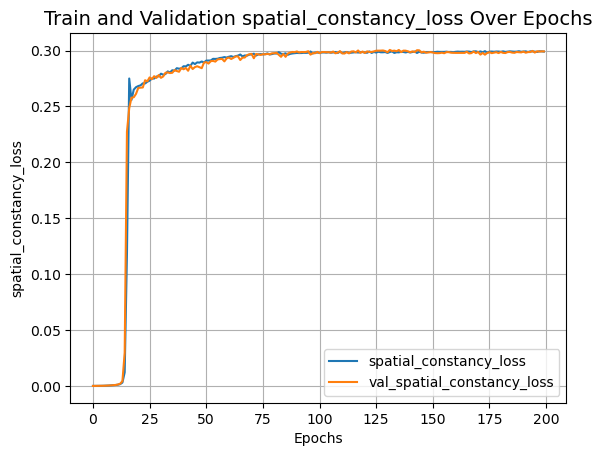

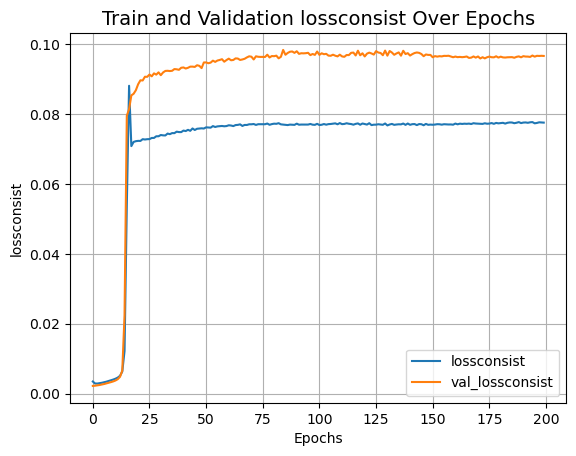

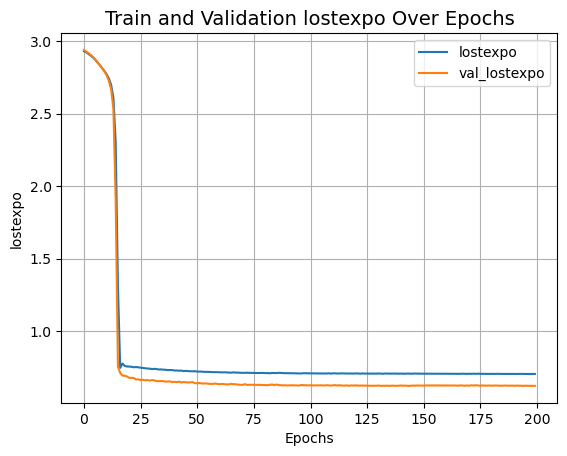

In [13]:
zero_dce_model = ZeroDCE()
zero_dce_model.compile(learning_rate=1e-4)
history = zero_dce_model.fit(train_dataset, validation_data=val_dataset, epochs=200)


def plot_result(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=14)
    plt.legend()
    plt.grid()
    plt.show()
    
def plot_resultcheck(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=16)
    plt.legend(item)
    plt.grid(item)
    plt.show(item)
print("16 font")
    


plot_result("total_loss")
plot_result("lostsm")
plot_result("spatial_constancy_loss")
plot_result("lossconsist")
plot_result("lostexpo")

In [14]:
def finresults(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def infer(initialimage):
    image = keras.utils.img_to_array(initialimage)
    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)
    finalimage = zero_dce_model(image)
    finalimage = tf.cast((finalimage[0, :, :, :] * 255), dtype=np.uint8)
    finalimage = Image.fromarray(finalimage.numpy())
    return finalimage

In [15]:
import numpy as np
import math
from PIL import Image

def MAEC(initialimage, finalimage):
    initialimagearray = np.array(initialimage)
    finalimagearray = np.array(finalimage)
    return np.mean(np.abs(initialimagearray - finalimagearray))

def MSEC(initialimage, finalimage):
    initialimagearray = np.array(initialimage)
    finalimagearray = np.array(finalimage)
    return np.mean((initialimagearray - finalimagearray) ** 2)

def PSNRC(initialimage, finalimage):
    mse = MSEC(initialimage, finalimage)
    if mse == 0:
        return float('inf')
    maxx = 255.0
    return 20*math.log10(maxx/math.sqrt(mse))

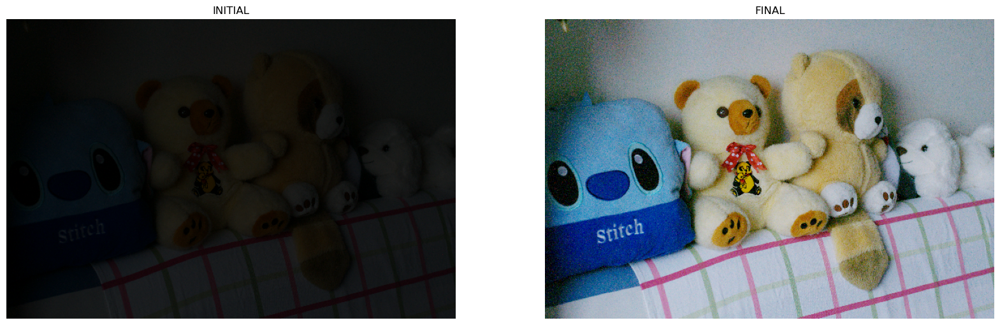

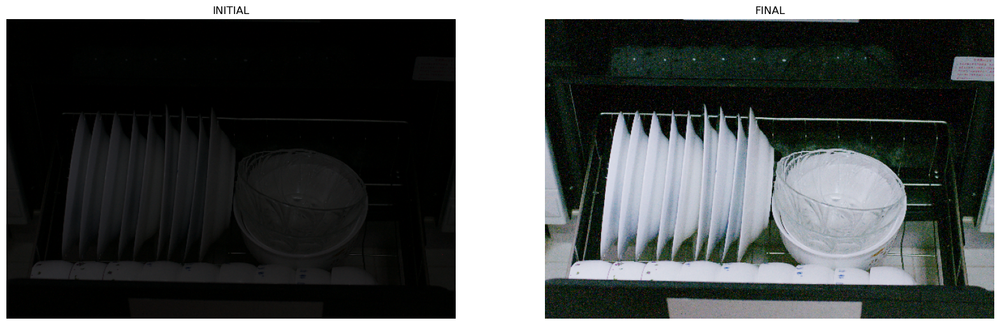

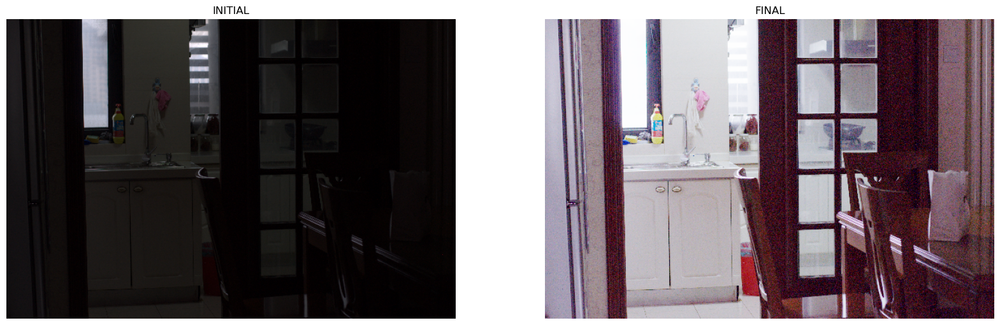

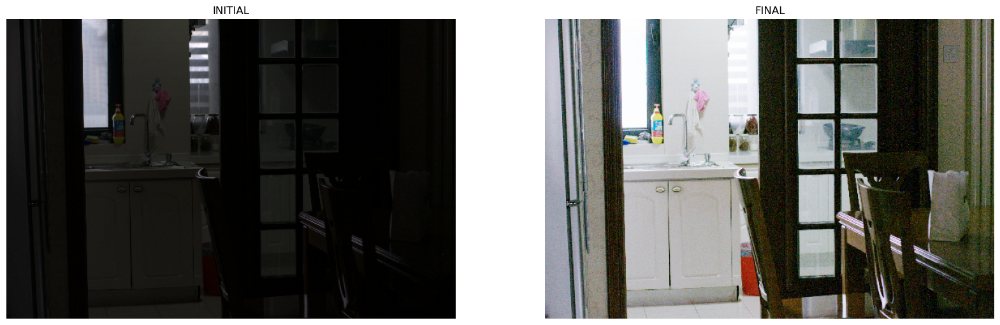

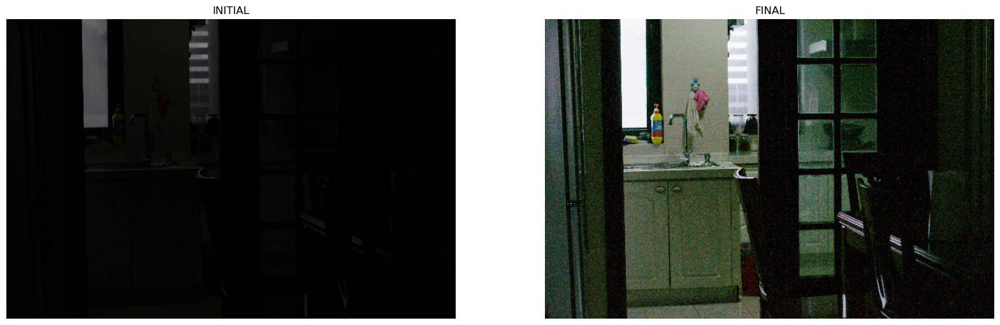

...

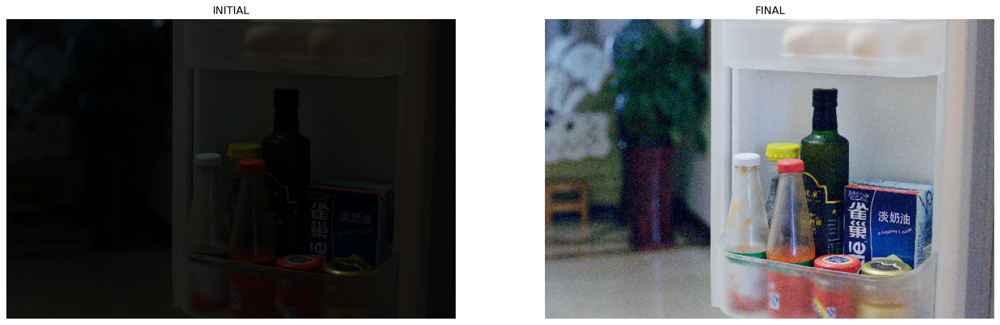

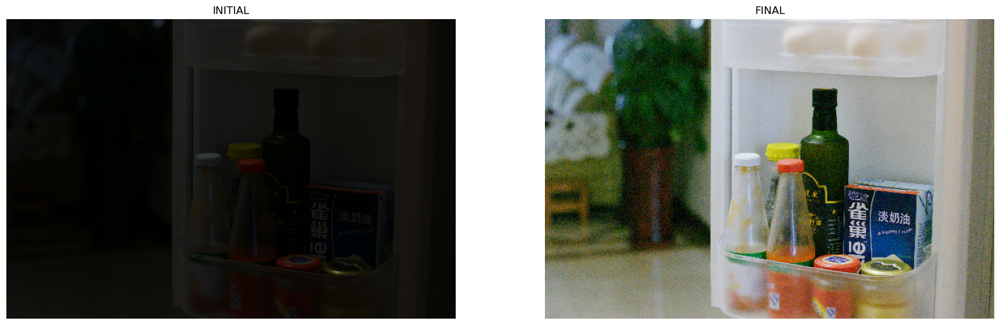

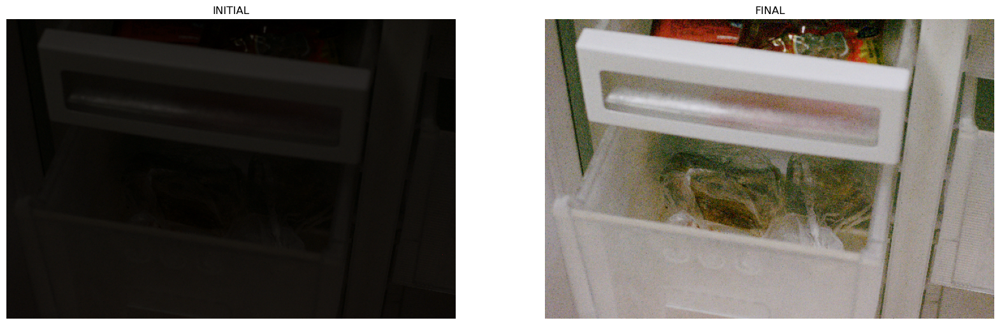

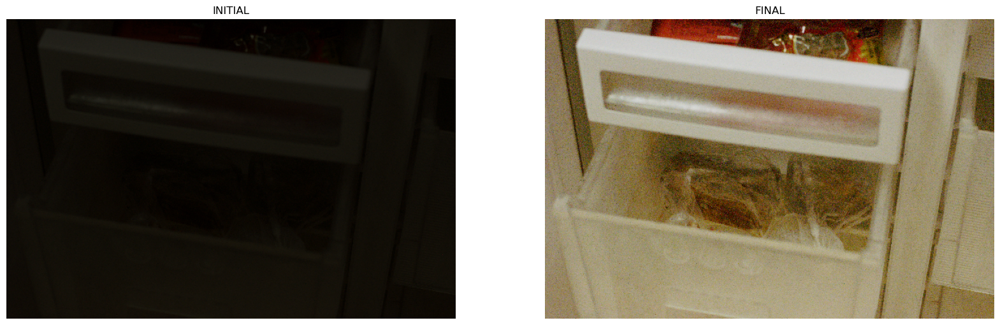

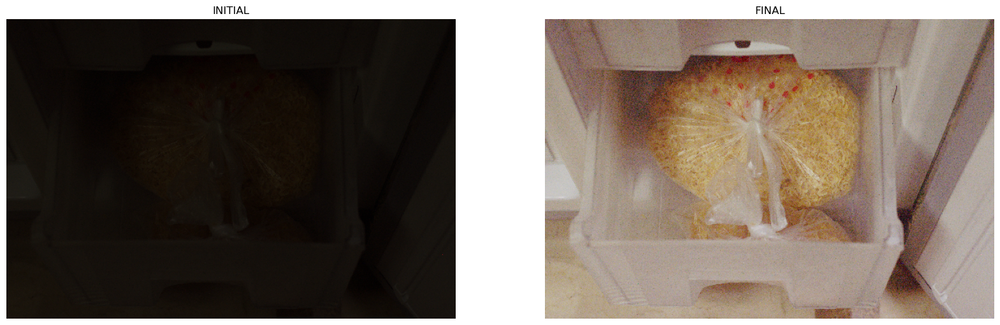

KeyboardInterrupt: 

In [25]:
summae = 0.0
summse = 0.0
sumpsnr = 0.0
ans = 0.0
for val_image_file in test_low_light_images:
    initiallimage = Image.open(val_image_file)
    finalimage = infer(initiallimage)
    finresults([initiallimage,  finalimage],["INITIAL",  "FINAL"],(20, 12),)
    mae = MAEC(initiallimage, finalimage)
    mse = MSEC(initiallimage, finalimage)
    psnr = PSNRC(initiallimage, finalimage)
    summae += mae
    summse += mse
    sumpsnr += psnr
    ans +=1
  

In [26]:
print("ans is keeping the count of number of images generated :",ans)
totaldatamae = summae / ans
totaldatamse = summse / ans
totaldatapsnr = sumpsnr / ans

print(" Mean Absolute Error (MAE) = ",totaldatamae)
print(" Mean Squared Error (MSE) = ",totaldatamse)
print(" Peak Signal-to-Noise Ratio (PSNR) = ",totaldatapsnr,"db")

ans is keeping the count of number of images generated : 28.0
 Mean Absolute Error (MAE) =  134.74807123015873
 Mean Squared Error (MSE) =  98.07105287698414
 Peak Signal-to-Noise Ratio (PSNR) =  28.240325581938663 db


In [1]:
import os
from PIL import Image

def save_image(image_data, folder_name='predicted', filename='finalimage.png'):
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)
    full_path = os.path.join(folder_name, filename)
    image_data.save(full_path)
    return full_path
